# 1.1 Visualize Atlas

In [1]:
import pandas as pd
import gene_exp_10x

import matplotlib.pyplot as plt
%matplotlib inline 
from copy import deepcopy

In [2]:
from clustergrammer2 import net

clustergrammer2 backend version 0.2.9


In [3]:
def umi_norm(df):
    # umi norm
    barcode_umi_sum = df.sum()
    df_umi = df.div(barcode_umi_sum)
    return df_umi

In [4]:
import random
def subsample_cats(df, cat_index, num_samples, sample_type='subsample', random_state=99):
    cols = df.columns.tolist()
    cats = sorted(list(set([x[cat_index] for x in cols])))
    
    if sample_type == 'subsample':
        keep_cols = []
        for inst_cat in cats:
            keep_cat_cols = [x for x in cols if x[cat_index] == inst_cat]

            if len(keep_cat_cols) > num_samples:
                keep_cat_cols = random.sample(keep_cat_cols, num_samples)

            keep_cols.extend(keep_cat_cols)

        df_sample = df[keep_cols]
        
    elif sample_type == 'downsample':
        df_list = []
        for inst_cat in cats:
            keep_cat_cols = [x for x in cols if x[cat_index] == inst_cat]
            df_cat = df[keep_cat_cols]

            if df_cat.shape[1] > num_samples:
                net.load_df(df_cat)            
                net.downsample(axis='col', ds_type='kmeans', num_samples=num_samples, random_state=random_state)
                df_ds = net.export_df()
            else:
                net.load_df(df_cat)
                net.downsample(axis='col', ds_type='kmeans', num_samples=df_cat.shape[1], random_state=random_state)
                df_ds = net.export_df()
                
            df_list.append(df_ds)
        df_sample = pd.concat(df_list, axis=1)
    
    return df_sample

### Load Metadata

In [5]:
df_meta = pd.read_csv('../download/atlas/meta.tab', sep='\t', index_col=0)
df_meta.shape

/Users/nickfernandez/anaconda3/envs/py36lab/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (27) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


(139331, 27)

### Load Atlas Gene Expression Data with top 5K top expressing genes

In [6]:
df_ini = gene_exp_10x.load_gene_exp_to_df('../download/atlas/atlas_data_5k-sum/')
df_ini.shape

(5000, 139331)

In [7]:
df_ini.columns.tolist()[:3]

['cell_1', 'cell_2', 'cell_3']

In [8]:
df_meta.columns.tolist()

['barcode',
 'sample',
 'stage',
 'sequencing.batch',
 'theiler',
 'doub.density',
 'doublet',
 'cluster',
 'cluster.sub',
 'cluster.stage',
 'cluster.theiler',
 'stripped',
 'celltype',
 'colour',
 'umapX',
 'umapY',
 'haem_gephiX',
 'haem_gephiY',
 'haem_subclust',
 'endo_gephiX',
 'endo_gephiY',
 'endo_trajectoryName',
 'endo_trajectoryDPT',
 'endo_gutX',
 'endo_gutY',
 'endo_gutDPT',
 'endo_gutCluster']

### Drop doublets

In [9]:
ser_doublet = df_meta['doublet']
ser_singlet = ser_doublet[ser_doublet == False]
print(ser_doublet.shape)
print(ser_singlet.shape)

(139331,)
(125775,)


In [10]:
ser_ct = df_meta['celltype']

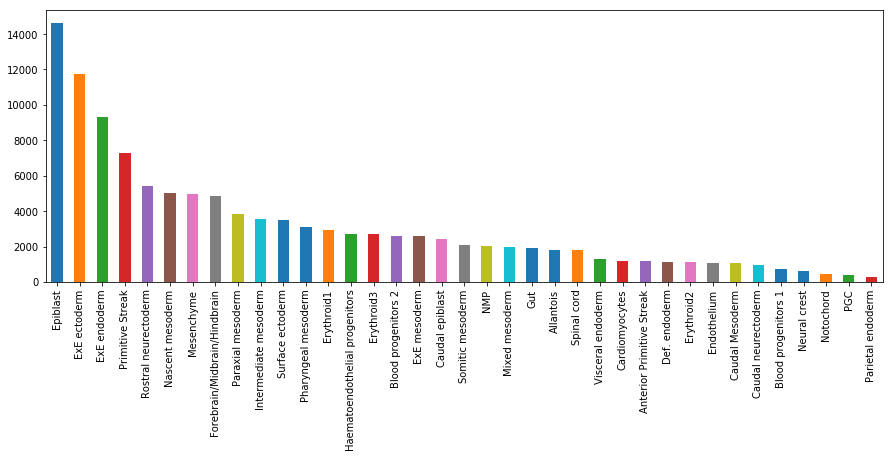

In [11]:
ser_ct.value_counts().sort_values(ascending=False).plot('bar', figsize=(15,5))

### Add Cell Type Category

In [12]:
cols = df_ini.columns.tolist()
new_cols = [(x, 'Cell Type: ' + str(ser_ct[x])) for x in cols]

In [13]:
print(new_cols[0])
df_cat = deepcopy(df_ini)
df_cat.columns = new_cols

('cell_1', 'Cell Type: Epiblast')


In [14]:
df_cat.columns.tolist()[:5]

[('cell_1', 'Cell Type: Epiblast'),
 ('cell_2', 'Cell Type: Primitive Streak'),
 ('cell_3', 'Cell Type: nan'),
 ('cell_4', 'Cell Type: nan'),
 ('cell_5', 'Cell Type: ExE ectoderm')]

# Subsample Cats

In [15]:
# num_cells = 10000
# df_small = umi_norm(df_cat.iloc[:,:num_cells])
# df_small.shape

In [17]:
df_small = subsample_cats(df_cat, cat_index=1, num_samples=250, sample_type='downsample')
df_small_umi = umi_norm(df_small)
df_small_umi.shape

ValueError: Seed must be between 0 and 2**32 - 1

# Subsample Cells across most variable genes

In [ ]:
net.load_df(df_small_umi)
net.filter_N_top(inst_rc='row', N_top=250, rank_type='var')
net.normalize(axis='row', norm_type='zscore')
net.clip(-5,5)
net.load_df(net.export_df().round(2))
net.widget()